Milestone 2 Phase 2<br>
Nama: Risqi Wahyu Permana<br>
batch: HCK 6

# Link

- Link Dataset : https://www.kaggle.com/datasets/iabhishekofficial/mobile-price-classification?select=train.csv
- Link Deploy : https://huggingface.co/spaces/wahyupermana10/Mobile_Phone_Price_Prediction

# Objective

Dataset yang digunakan adalah dataset mengenai spesifikasi mobile phone. Dataset ini berisi berbagai macam spek mobile phone yang saya rasa dari berbagai tahun.

Objective dari pembuatan model ini adalah memprediksi kelas harga dari sebuah mobile phone berdasarkan spesifikasinya. Prediksi dilakukan dengan menggunakan 6 jenis model supervised kemudian dipilih yang terbaik untuk dilakukan inference. Semua model dilakukan cv dan hyperparameter tuning sebelum diputuskan menggunakan model yang mana.

# Problem

Seorang bos besar di negara x ingin merintis perusahaan mobile phone baru. Akan tetapi dia tidak mengetahui harga dari mobile phone yang akan perusahaan dia buat. Dia kebingungan jika menggunakan kombinasi - kombinasi dari komponen berbeda, berapa harga yang harus diberikan pada mobile phone itu. Sehingga dia meminta bantuan saya sebagai orang yang bisa menggunakan machine learning untuk membantu menentukan harga dari produk yang dia buat menggunakan machine learning.

Untuk metric yang digunakan untuk menilai model adalah accuracy. Menggunakan Accuracy karena yang pertama dataset sudah seimbang dan tidak ada yang perlu diminimalisir. Saya perlu mengetahui spek mobile phone segini kira - kira harganya berapa, sehingga digunakan akurasi.

# Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report, f1_score, make_scorer, confusion_matrix, ConfusionMatrixDisplay, recall_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier
from dataprep.eda import create_report
import joblib

import warnings
warnings.filterwarnings(action='ignore')

%matplotlib inline

# Function

In [2]:
#VIF
def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

In [3]:
def normal(df,col):
    upper = df[col].mean() + (3 * df[col].std())
    lower = df[col].mean() - (3 * df[col].std())

    outlier = df[(df[col] <= lower) | (df[col] >= upper)]

    print('percentage: ', len(outlier)/df.shape[0] * 100, '%')

def skew(df, col, fold):
    Q1 = df[col].quantile(.25)
    Q3 = df[col].quantile(.75)

    IQR = Q3 - Q1

    upper = Q3 + (fold*IQR)
    lower = Q1 - (fold*IQR)

    outlier = df[(df[col] <= lower) | (df[col] >= upper)]

    print('percentage: ', len(outlier)/df.shape[0] * 100, '%')
    print('upper: ', upper)
    print('lower: ', lower)

In [4]:
#Function to plot distribution
def plot_dist(df, col):
    fig, axes = plt.subplots(ncols = 2, figsize = (15, 5))
    
    # histogram
    sns.histplot(df[col],ax = axes[0], bins=30)
    axes[0].set_title(f"Histogram '{col}'")
    axes[0].axvline(df[col].mean(), color = 'red', linestyle = 'dashed', label = 'mean')
    axes[0].axvline(df[col].median(), color = 'green', linestyle = 'dashed', label = 'median')
    axes[0].legend()
    
    # boxplot
    sns.boxplot(y=df[col], ax =  axes[1])
    axes[1].set_title(f"Boxplot '{col}'")
    
    plt.show()
    
    # skewness
    print(df[col].name + ' Kurtosis: ' + str(df[col].kurt()))
    print(df[col].name + ' Skewness: ' + str(df[col].skew()))
    if -0.5 <= df[col].skew() <= 0.5:
        print("Columns '{}' normal distribution".format(col))
        normal(df, col)
    elif df[col].skew() > 0.5:
        if df[col].skew() > 1:
            print("Columns '{}' extreme right skewed".format(col))
            skew(df, col, 3)
        else:
            print("Columns '{}' right skewed".format(col))
            skew(df, col, 1.5)
    elif df[col].skew() < -0.5:
        if df[col].skew() < 1:
            print("Columns '{}' extreme left skewed".format(col))
            skew(df, col, 3)
        else:
            print("Columns '{}' left skewed".format(col))
            skew(df, col, 1.5)
    


# Data Loading

In [5]:
#no limit df display
pd.set_option('display.max_columns', None)

In [6]:
df = pd.read_csv('train.csv')
df.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1


In [7]:
df.tail()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
1995,794,1,0.5,1,0,1,2,0.8,106,6,14,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,3,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,3,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,5,336,670,869,18,10,19,1,1,1,0
1999,510,1,2.0,1,5,1,45,0.9,168,6,16,483,754,3919,19,4,2,1,1,1,3


Penjelasan mengenai kolom - kolom pada dataset.

- battery_power: Total energi yang bisa disimpan oleh baterai dalam satuan mAh.
- blue: Apakah mobile phone mempunyai Bluetooh atau tidak.
- clock_speed: Kecepatan processor untuk mengeksekusi sebuah tugas.
- dual_sim: Apakah mobile phone mendukung dual sim atau tidak.
- fc: Nilai mega pixels dari kamera depan.
- four_g: Apakah mobile phone mendukung signal 4g atau tidak.
- int_memory: Berapa besar penyimpanan internal.
- m_dep: Kedalaman dari mobile phone.
- mobile_wt: Berat dari mobile phone
- n_cores: Jumlah core dari processor.
- pc: Nilai mega pixels dari kamera belakang.
- px_height: resolusi panjang dari mobile phone.
- px_width: resolusi lebar dari mobile phone.
- ram: Berapa besar ram dari mobile phone tersebut.
- sc_h: Berapa panjang layar mobile phone.
- sc_w: Berapa lebar layar mobile phone.
- talk_time: Kemampuan baterai mobile phone untuk bertahan dalam satu kali pengecasan.
- three_g: Apakah mobile phone mendukung signal 3g atau tidak.
- touch_screen: Apakah mobile phone memiliki layar yang mendukung layar sentuh atau tidak.
- wifi: Apakah mobile phone mendukung teknologi wifi atau tidak.
- price_range: Ini adalah kolom target yang dimana terdapat empat jenis pembeda, yaitu:
    - 0: low cost.
    - 1: medium cost.
    - 2: high cost.
    - 3: very high cost.


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

In [9]:
df.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,9.916500,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,6.064315,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,0.000000,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,5.000000,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,10.000000,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,15.000000,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,20.000000,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


# Data Cleaning

In [10]:
df.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [11]:
df.duplicated().sum()

0

Tidak Terdapat data dengan null value maupun data duplikat.

# EDA For Analysis

## Correlation RAM Capacity and Price Range

<Axes: xlabel='ram', ylabel='price_range'>

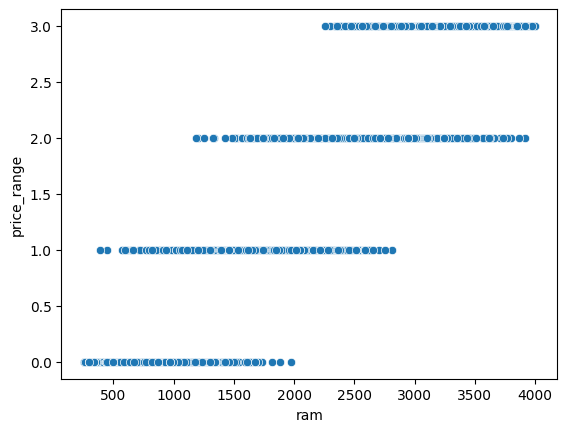

In [12]:
#group ram and price_range and scatter plot
sns.scatterplot(data=df, x='ram', y='price_range')

Kita dapat melihat bahwa semakin tinggi kapasitas RAM, semakin mahal harga ponsel tersebut.

## Correlation Battery Power and Price Range

<Axes: xlabel='battery_power', ylabel='price_range'>

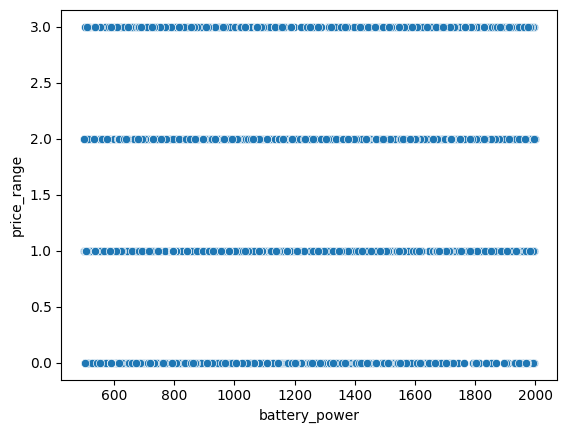

In [13]:
#scatter plot battery_power and price_range
sns.scatterplot(data=df, x='battery_power', y='price_range')

Kita bisa melihat bahwa ponsel dengan kapasitas baterai dari yang kecil hingga yang besar memiliki harga yang murah dan mahal juga.

## Display Resolution

<Axes: xlabel='px_height', ylabel='px_width'>

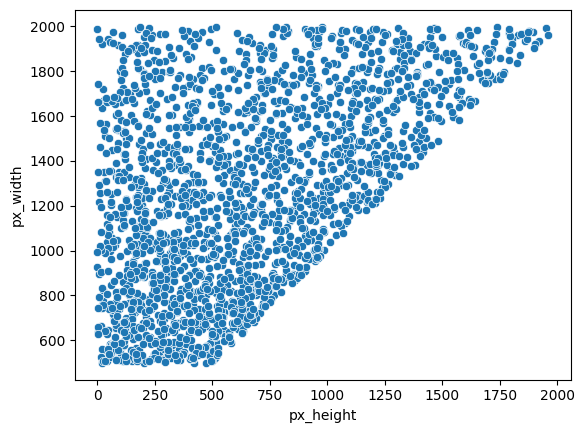

In [14]:
#scatter plot px_height and px_width
sns.scatterplot(data=df, x='px_height', y='px_width')

Kita dapat melihat bahwa ada korelasi antara px_height dan px_width. Semakin tinggi px_height, semakin tinggi pula px_width.

## Correlation Between Number of Cores and Clock Speed

<Axes: xlabel='clock_speed', ylabel='n_cores'>

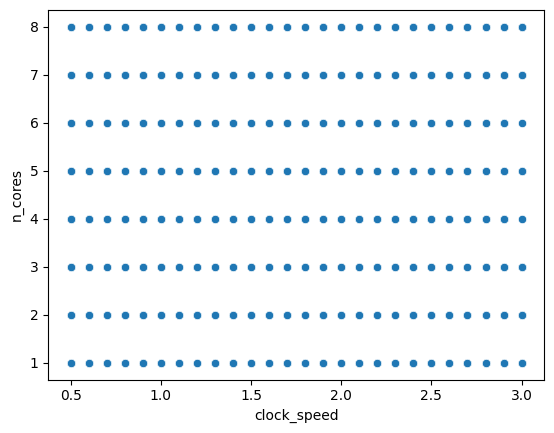

In [15]:
#scatter plot n_cores and clock_speed
sns.scatterplot(data=df, x='clock_speed', y='n_cores')

Kita dapat menyimpulkan bahwa jumlah core dan kecepatan clock tidak berhubungan. Ada prosesor yang memiliki jumlah core yang banyak tetapi memiliki kecepatan clock yang rendah dan sebaliknya.

## Price Range

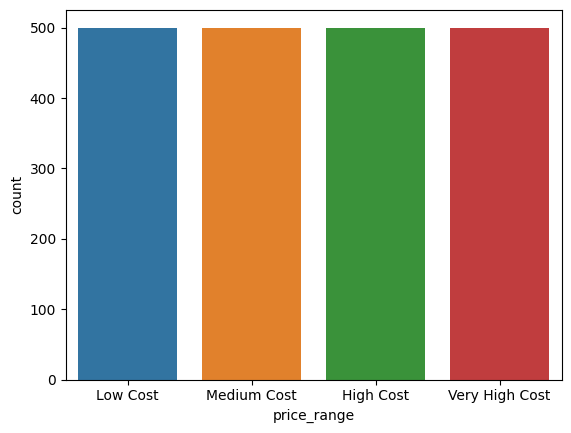

In [16]:
#barplot price_range
sns.countplot(x='price_range', data=df)
plt.xticks([0, 1, 2, 3], ['Low Cost', 'Medium Cost', 'High Cost', 'Very High Cost'])
plt.show()

Kisaran harga adalah variabel target dengan nilai 0 (biaya rendah), 1 (biaya sedang), 2 (biaya tinggi), dan 3 (biaya sangat tinggi).

Dapat kita lihat keseluruhan data target seimbang.

# EDA for Modeling

## Proses EDA

Melakuakan EDA menggunakan bantuan library `dataprep`.

  0%|          | 0/3346 [00:00<?, ?it/s]

DataPrep Report
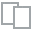
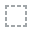
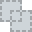
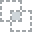
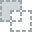
...
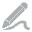
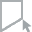
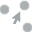
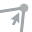
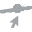

In [17]:
create_report(df)

## Mengecek proporsi target yaitu price_range

In [18]:
#check price range value
df['price_range'].value_counts()

1    500
2    500
3    500
0    500
Name: price_range, dtype: int64

## Mengecek secara manual persebaran data dan jumlah outliernya

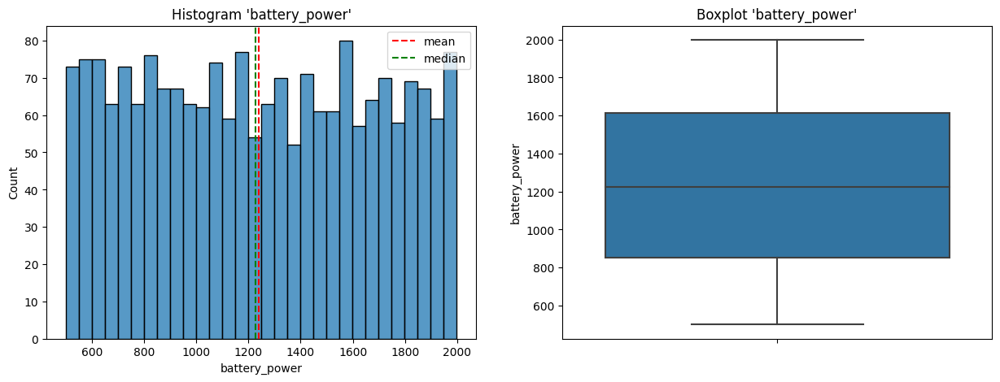

battery_power Kurtosis: -1.2241438831965528
battery_power Skewness: 0.03189847179278164
Columns 'battery_power' normal distribution
percentage:  0.0 %


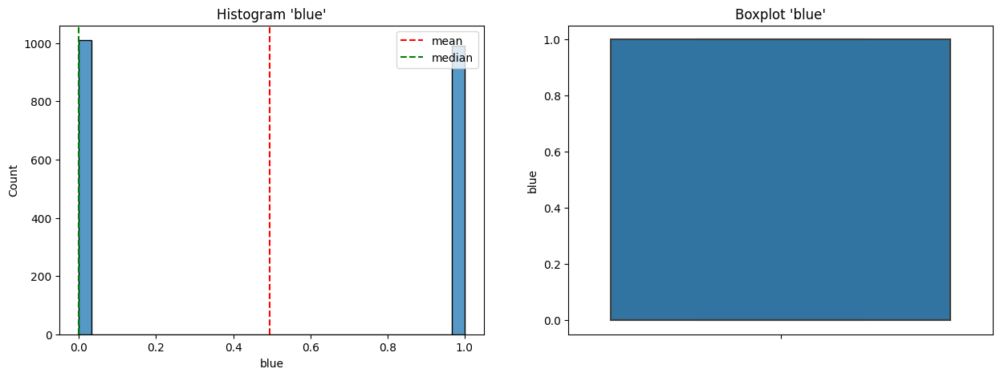

blue Kurtosis: -2.0016019625995645
blue Skewness: 0.020016015215014945
Columns 'blue' normal distribution
percentage:  0.0 %


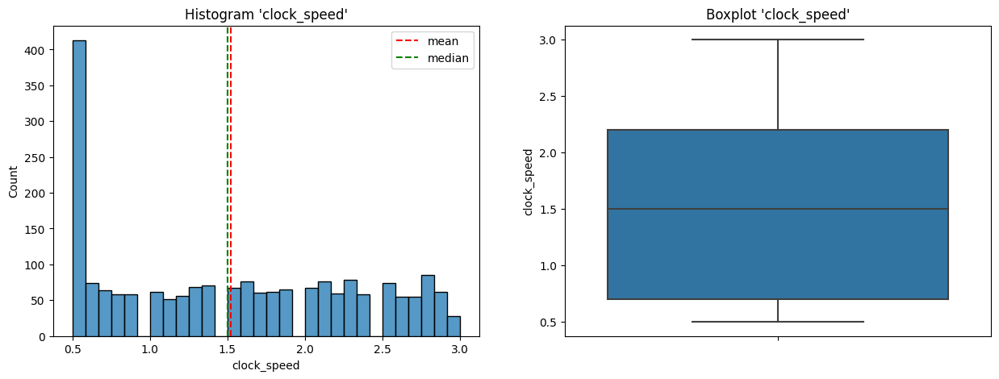

clock_speed Kurtosis: -1.3234172221019123
clock_speed Skewness: 0.1780841202790887
Columns 'clock_speed' normal distribution
percentage:  0.0 %


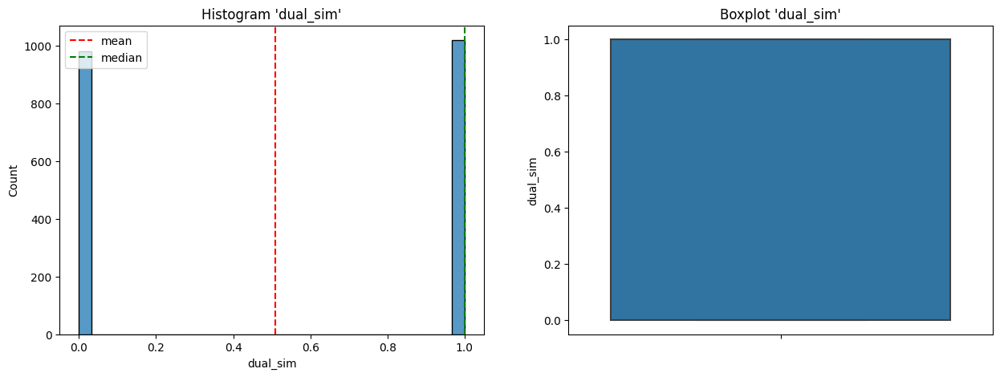

dual_sim Kurtosis: -2.0005548652196294
dual_sim Skewness: -0.03803539334775485
Columns 'dual_sim' normal distribution
percentage:  0.0 %


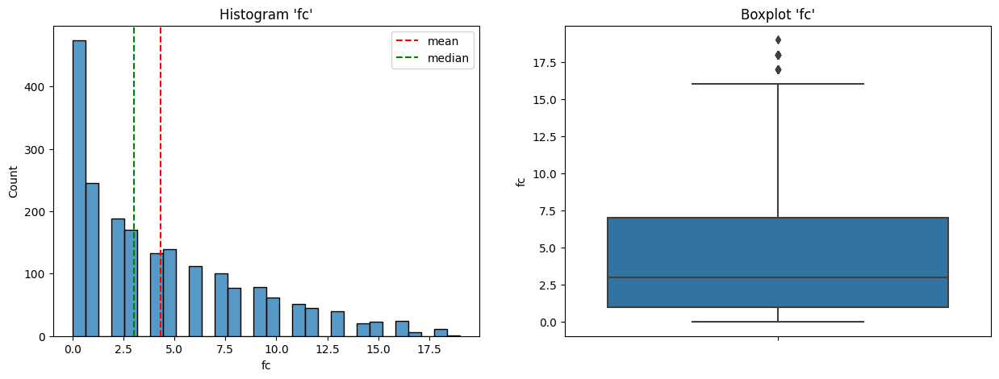

fc Kurtosis: 0.2770763245651877
fc Skewness: 1.0198114105315519
Columns 'fc' extreme right skewed
percentage:  0.0 %
upper:  25.0
lower:  -17.0


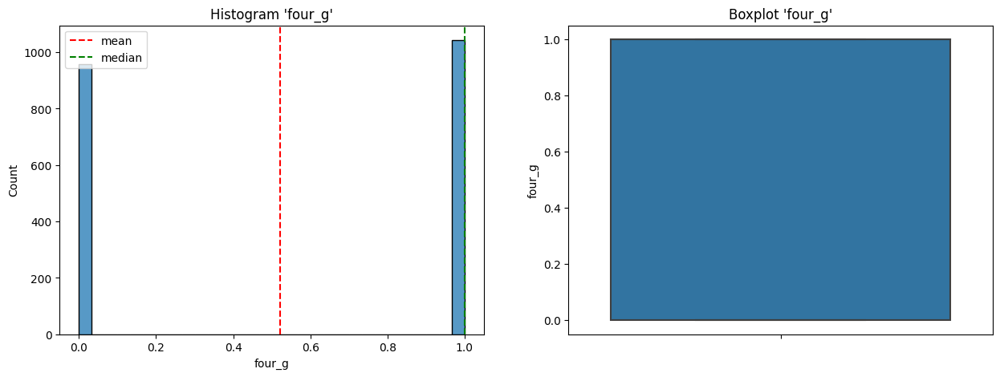

four_g Kurtosis: -1.9945747463198134
four_g Skewness: -0.08614423907054716
Columns 'four_g' normal distribution
percentage:  0.0 %


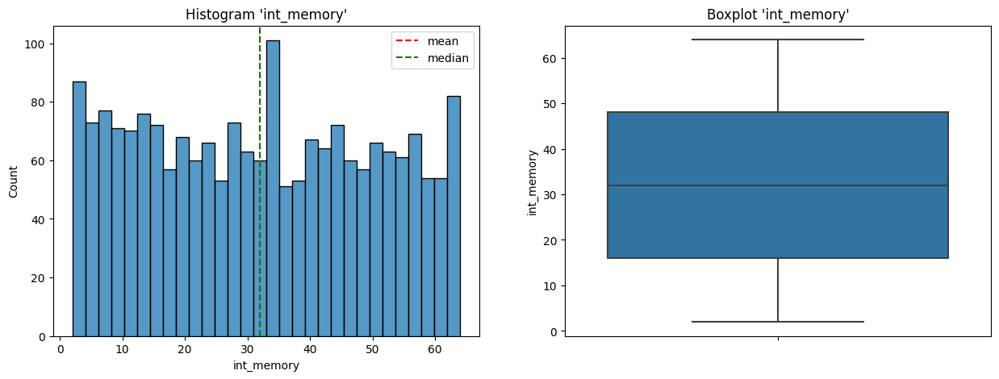

int_memory Kurtosis: -1.2160740301516093
int_memory Skewness: 0.05788932785206039
Columns 'int_memory' normal distribution
percentage:  0.0 %


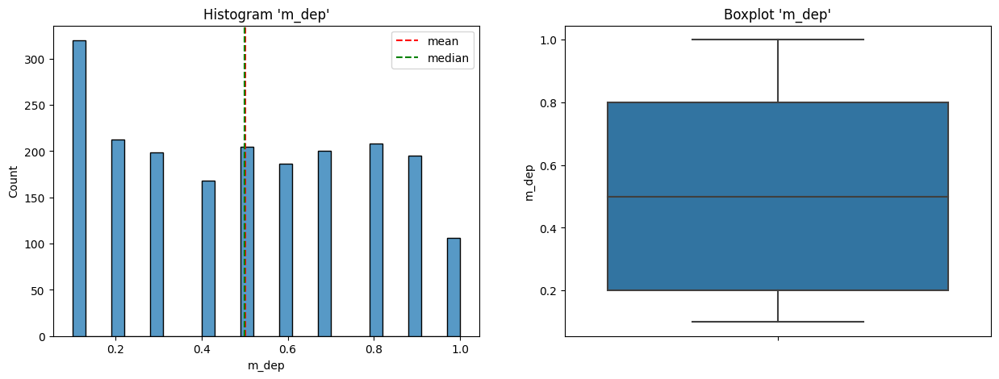

m_dep Kurtosis: -1.2743488835633268
m_dep Skewness: 0.08908200979245855
Columns 'm_dep' normal distribution
percentage:  0.0 %


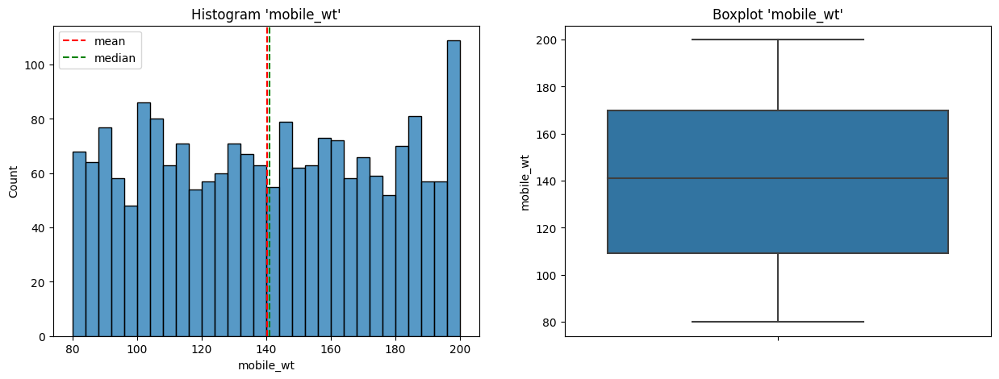

mobile_wt Kurtosis: -1.2103764737553446
mobile_wt Skewness: 0.006558157428692449
Columns 'mobile_wt' normal distribution
percentage:  0.0 %


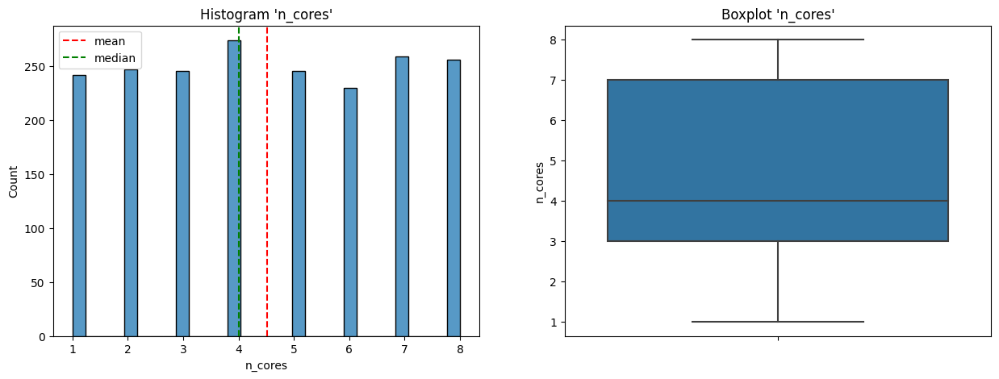

n_cores Kurtosis: -1.229749766610346
n_cores Skewness: 0.0036275083137803994
Columns 'n_cores' normal distribution
percentage:  0.0 %


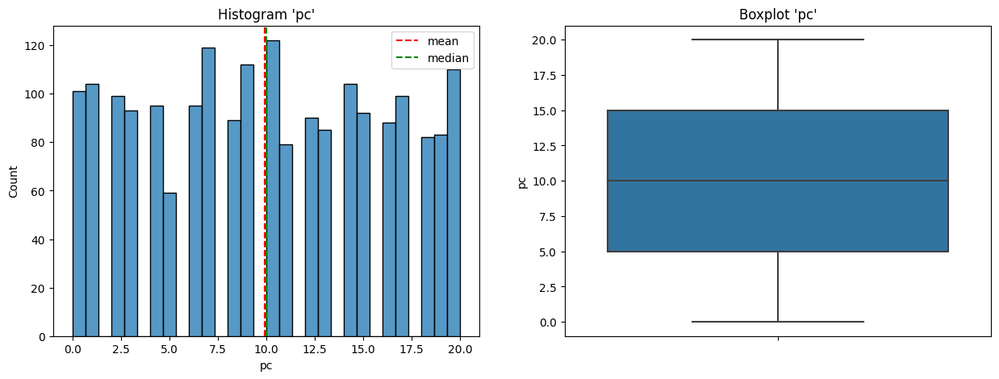

pc Kurtosis: -1.1714987948421944
pc Skewness: 0.017306150471392553
Columns 'pc' normal distribution
percentage:  0.0 %


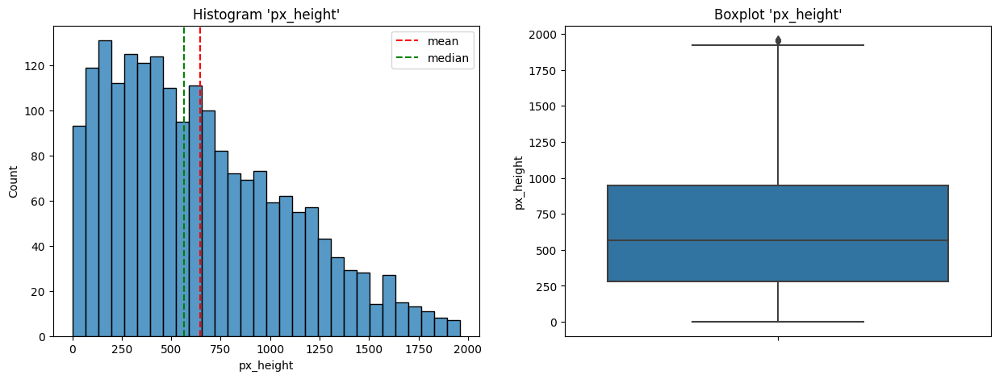

px_height Kurtosis: -0.3158654936040146
px_height Skewness: 0.6662712560691598
Columns 'px_height' right skewed
percentage:  0.1 %
upper:  1944.0
lower:  -714.0


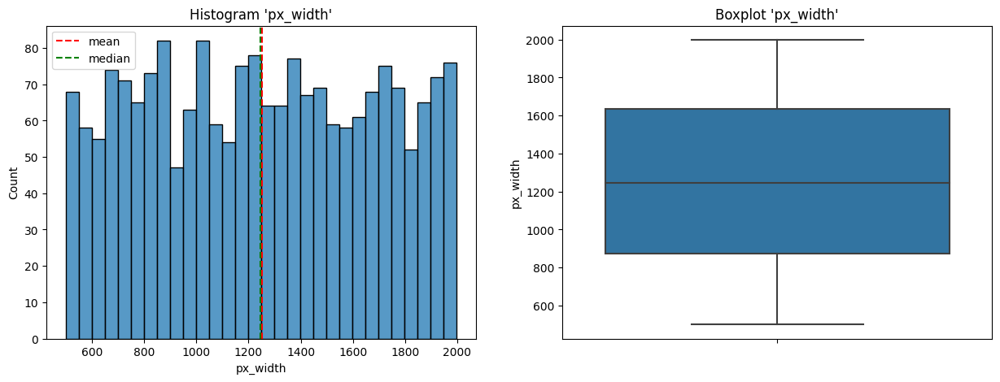

px_width Kurtosis: -1.186005229243282
px_width Skewness: 0.014787473768006081
Columns 'px_width' normal distribution
percentage:  0.0 %


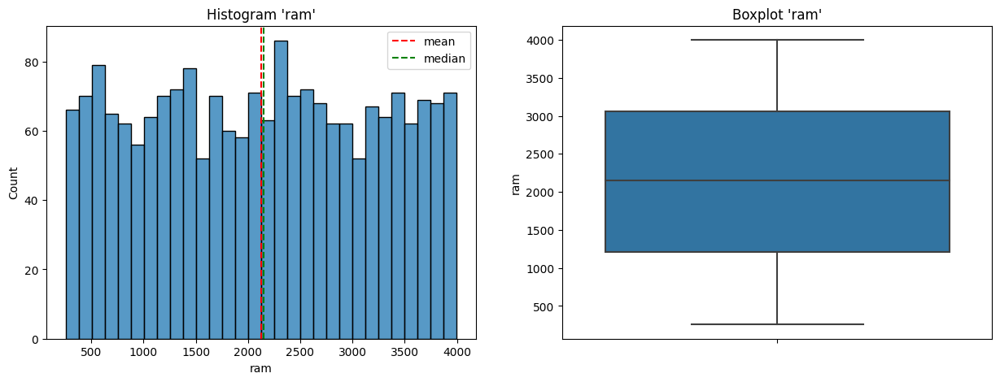

ram Kurtosis: -1.1919130700631546
ram Skewness: 0.006628035398750348
Columns 'ram' normal distribution
percentage:  0.0 %


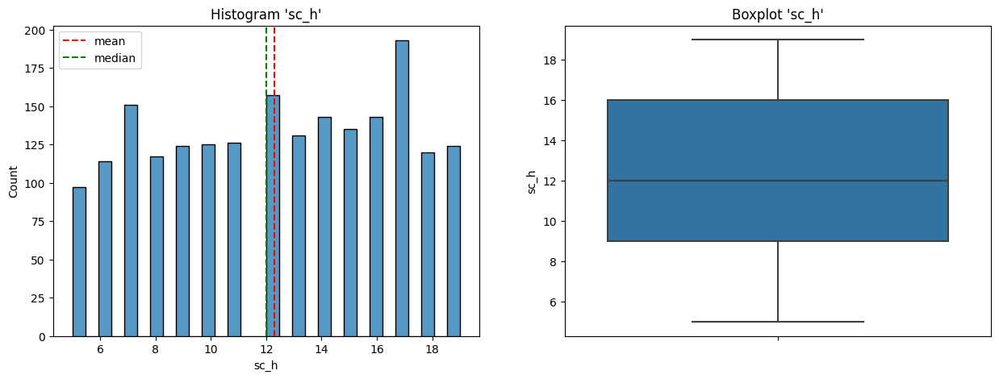

sc_h Kurtosis: -1.1907912468413369
sc_h Skewness: -0.09888424098283438
Columns 'sc_h' normal distribution
percentage:  0.0 %


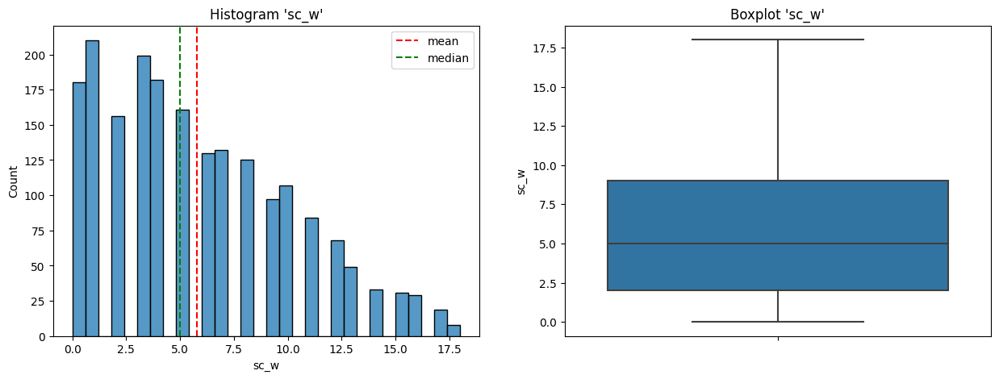

sc_w Kurtosis: -0.3895227893524629
sc_w Skewness: 0.6337870734456067
Columns 'sc_w' right skewed
percentage:  0.0 %
upper:  19.5
lower:  -8.5


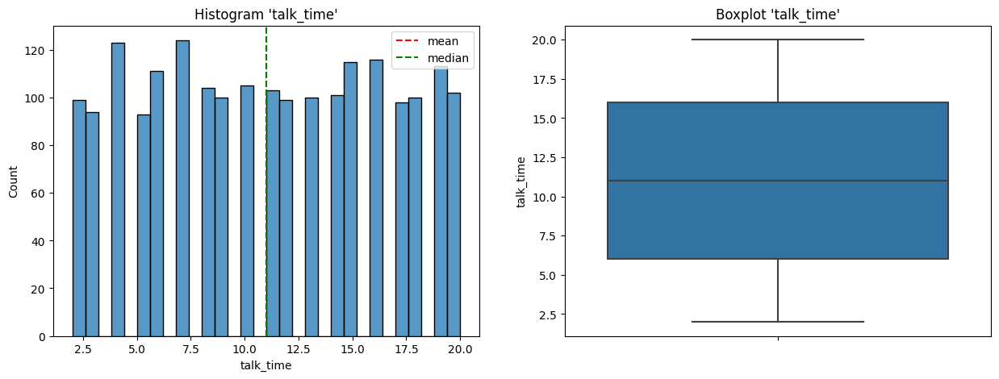

talk_time Kurtosis: -1.2185909629106917
talk_time Skewness: 0.009511762221541457
Columns 'talk_time' normal distribution
percentage:  0.0 %


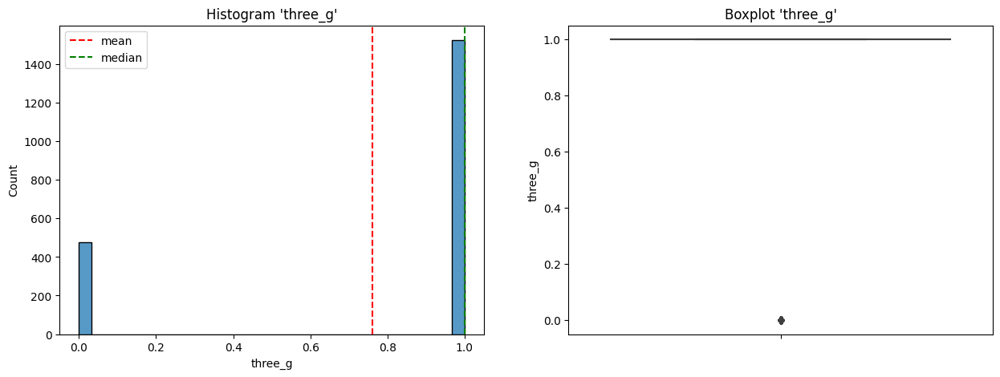

three_g Kurtosis: -0.4921612878504602
three_g Skewness: -1.2281416344153246
Columns 'three_g' extreme left skewed
percentage:  100.0 %
upper:  1.0
lower:  1.0


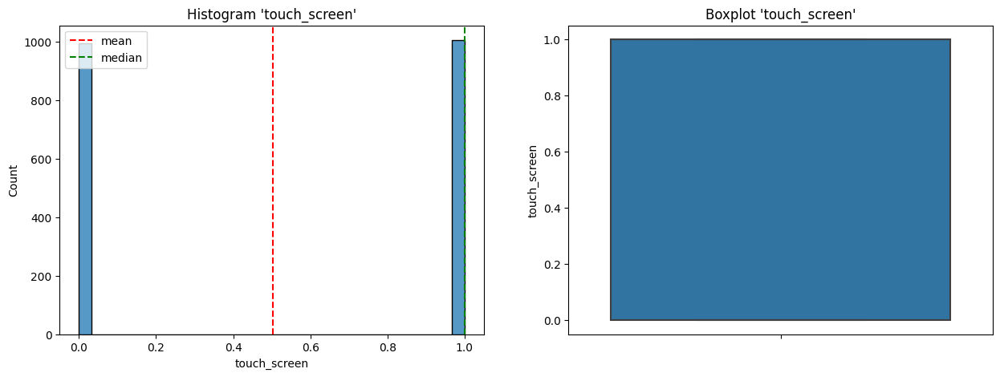

touch_screen Kurtosis: -2.0018586386605075
touch_screen Skewness: -0.012009224801531652
Columns 'touch_screen' normal distribution
percentage:  0.0 %


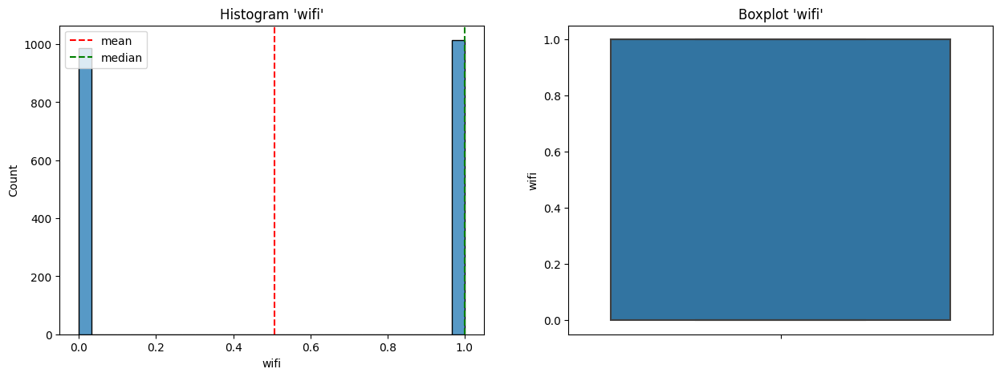

wifi Kurtosis: -2.0012168868938183
wifi Skewness: -0.028023766608637157
Columns 'wifi' normal distribution
percentage:  0.0 %


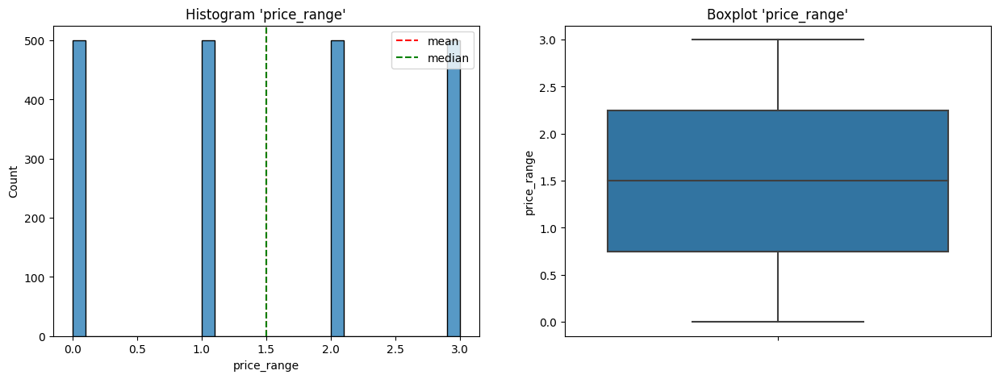

price_range Kurtosis: -1.360400119699068
price_range Skewness: 0.0
Columns 'price_range' normal distribution
percentage:  0.0 %


In [19]:
for i in df.columns:
    plot_dist(df, i)

## Mengecek korelasi menggunakan phik

In [20]:
from phik.report import plot_correlation_matrix

In [21]:
interval_col = ['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'price_range']
phik_overview = df.phik_matrix(interval_cols=interval_col)

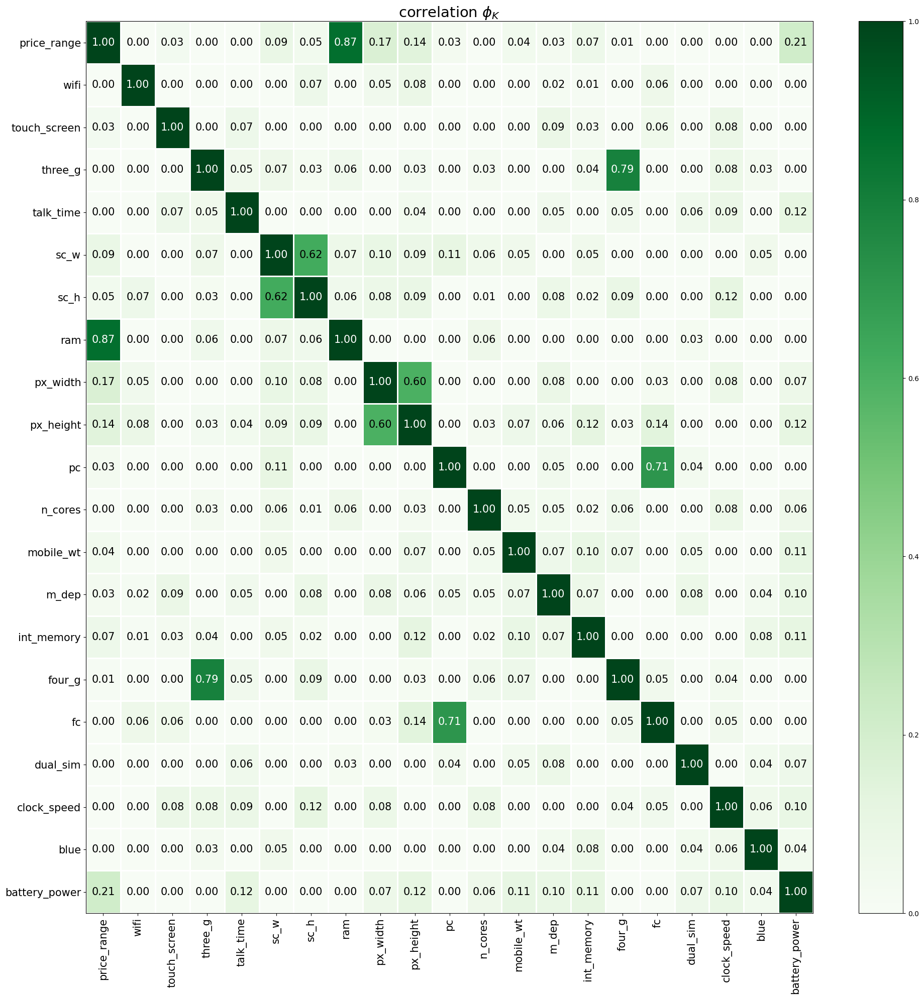

In [22]:
plot_correlation_matrix(phik_overview.values, 
                        x_labels=phik_overview.columns, 
                        y_labels=phik_overview.index, 
                        vmin=0, vmax=1, color_map="Greens", 
                        title=r"correlation $\phi_K$", 
                        fontsize_factor=1.5, 
                        figsize=(20, 20))
plt.tight_layout()

## Kesimpulan EDA

Dari EDA diatas dapat disimpulkan:
- Tidak terdapat missing value.

- Tidak terdapat data duplikat.

- Terdapat 8 data categorical namun sudah diubah kedalam bentuk numerik. Data tersebut yaitu:

    - blue, dual_sim, four_g, n_cores, three_g, touch_screen, wifi dan price_range.
<br><br>
- Terdapat 13 data numerical yaitu:

    - battery_power, clock_speed, fc, int_memory, m_dep, mobile_wt, pc, px_height, px_width, ram, sc_h, sc_w dan talk_time.
<br><br>
- Dari keseluruhan kolom tersebut tidak ada yang memiliki outliers dan rata - rata memiliki persebaran data normal.

- Proposional dari data target seimbang semuanya. Target dikelompokan menjadi 4 kelompok. Masing - masing memiliki jumlah proposional yang seimbang, yaitu 500 pada setiap kategori.

# Feature Selection

Pada section ini saya akan memilih fitur yang akan digunakan. Fitur yang dipilih dipetimbangkan berdasarkan nilai korelasi dan domain knowledge. Untuk `threshold` yang digunakan adalah 0,1. Untuk domain knowledge berdasarkan standar mobile phone 2023.

Fitur yang diambil yaitu:

- battery_power: Merupakan salah satu pertimbangan penting ketika membeli mobile phone, orang akan cenderung membeli mobile phone dengan kapasitas battery yang besar karena akan berpengaruh pada lamanya seseorang menggunakan perangkat tersebut berdasarkan sekali charge.

- clock speed: Menurut saya clock speed merupakan salah satu hal yang menjadi pertimbangan class dari perangkat mobile tersebut. Semakin tinggi clock speed maka semakin baik kinerja cpu untuk mengerjakan sesuatu dan harga mobile phone tersebut akan semakin meningkat pula.

- fc: Pada tahun 2023, kamera depan telah menjadi salah satu hal yang dipertimbangkan untuk membeli mobile phone. Contohnya sebagai pekerja yang sering live streaming.

- four_g: Kemampuan menangkap signal 4g merupakan hal yang penting pada tahun 2023. Minimal sebuah mobile phone sudah dapat menangkap signal 4g. Untuk kemampuan menangkap signal 3g saya rasa itu sudah menjadi standar mobile phone dari tahun 2013 sehingga tidak akan saya gunakan kolom tersebut dan hanya memakai kolom 4g.

- int_memory: Penyimpanan internal merupakan salah satu hal yang penting untuk dipertimbangkan kektika seseorang ingin membeli mobile data. Semakin besar int_memory semakin mahal pula harga mobile phone tersebut.

- n_cores: Menurut saya jumlah core dari sebuah prosesor merupakan salah satu yang mempengaruhi harga dari sebuah mobile phone. Semakin banyak jumlah n_cores maka semakin bagus mobile phone tersebut.

- pc: Kamera utama merupakan salah satu hal yang mempengaruhi seseorang membeli perangkat tersebut dan juga mempengaruhi harga perangkat tersebut.

- px_height dan px_width: Kedua kolom ini saling berhubungan. Semakin tinggi nilai resolusi dari kedua kolom ini maka akan semakin mahal perangkat mobile tersebut.

- ram: RAM merupakan salah satu faktor penting pada sebuah perangkat. Semakin besar ram perangkat tersebut maka kemampuan perangkat tersebut untuk menjalankan dan berpindah - pindah aplikasi tanpa aplikasi tersebut tertutup semakin banyak. Biasanya jika jumlah ram besar maka harganya semakin mahal pula.

In [23]:
#take only important feature
df_feat = df[['battery_power', 'clock_speed', 'fc', 'four_g', 'int_memory', 'n_cores', 'pc', 'px_height', 'px_width', 'ram', 'price_range']]

## Melihat nilai VIF

In [24]:
#Hitung nilai vif
calc_vif(df_feat.drop(columns=['price_range']))

,variables,VIF
0,battery_power,6.964446
1,clock_speed,4.031348
2,fc,3.401341
3,four_g,2.027258
4,int_memory,3.746853
5,n_cores,4.327829
6,pc,6.040066
7,px_height,4.227230
8,px_width,10.595431
9,ram,4.398695


Walaupun terdapat nilai vif yang besar pada beberapa kolom. Tapi tidak akan saya drop karena sebenarnya kolom - kolom tersebut menurut saya tidak saling berhubungan.

# Preprocessing

In [25]:
num_col = ['battery_power', 'clock_speed', 'fc', 'int_memory', 'pc', 'px_height', 'px_width', 'ram']
cat_cal = ['four_g', 'n_cores']

In [26]:
#split data
X = df_feat.drop(columns=['price_range'])
y = df_feat['price_range']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101, stratify=y)

In [27]:
# Because the data is very good, we don't need any treatment for outliers and skewness
# So we just need use scaling for numerical data.

num_pipeline = Pipeline([
    ('scaler', MinMaxScaler()),
    ('imputer', 'passthrough')
])

cat_pipeline = Pipeline([
    ('imputer', 'passthrough')
])

transform_pipeline = ColumnTransformer([
    ('numeric', num_pipeline, num_col),
    ('categorical', cat_pipeline, cat_cal)
])

train_tr = transform_pipeline.fit_transform(X_train)
test_tr = transform_pipeline.transform(X_test)

In [28]:
transform_pipeline

ColumnTransformer(transformers=[('numeric',
                                 Pipeline(steps=[('scaler', MinMaxScaler()),
                                                 ('imputer', 'passthrough')]),
                                 ['battery_power', 'clock_speed', 'fc',
                                  'int_memory', 'pc', 'px_height', 'px_width',
                                  'ram']),
                                ('categorical',
                                 Pipeline(steps=[('imputer', 'passthrough')]),
                                 ['four_g', 'n_cores'])])

# Modeling

In [29]:
#Make pipeline

pipe_lr = Pipeline([
    ('transform', transform_pipeline),
    ('model', LogisticRegression())
])

pipe_svc = Pipeline([
    ('transform', transform_pipeline),
    ('model', SVC())
])

pipe_knn = Pipeline([
    ('transform', transform_pipeline),
    ('model', KNeighborsClassifier())
])

pipe_dt = Pipeline([
    ('transform', transform_pipeline),
    ('model', DecisionTreeClassifier())
])

pipe_rf = Pipeline([
    ('transform', transform_pipeline),
    ('model', RandomForestClassifier())
])

pipe_gb = Pipeline([
    ('transform', transform_pipeline),
    ('model', GradientBoostingClassifier())
])


# Training

## Logistic Regression

In [30]:
#Cross Validation
score_lr = cross_val_score(pipe_lr, X_train, y_train, cv=10, scoring='accuracy')

print(score_lr)
print(score_lr.mean())

[0.925   0.93125 0.9125  0.94375 0.89375 0.91875 0.9375  0.94375 0.95
 0.91875]
0.9274999999999999


In [31]:
#hyperparameter tuning
param_lr = {
    'model__C': [0.1, 1, 10, 100],
    'model__solver': ['newton-cg', 'liblinear', 'sag', 'saga', 'lbfgs'],
    'model__max_iter': [2000, 3000]
}

grid_lr = GridSearchCV(pipe_lr, param_grid=param_lr, cv=10, scoring='accuracy', n_jobs=-1, verbose=1)

grid_lr.fit(X_train, y_train)

grid_lr.best_params_

Fitting 10 folds for each of 40 candidates, totalling 400 fits


{'model__C': 100, 'model__max_iter': 2000, 'model__solver': 'newton-cg'}

In [32]:
#Train model and predict using best estimator
logreg_best = grid_lr.best_estimator_
logreg_best.fit(X_train, y_train)

y_pred_lr_train = logreg_best.predict(X_train)
y_pred_lr_test = logreg_best.predict(X_test)

print(classification_report(y_train, y_pred_lr_train))
print(classification_report(y_test, y_pred_lr_test))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       400
           1       0.95      0.96      0.95       400
           2       0.94      0.94      0.94       400
           3       0.97      0.97      0.97       400

    accuracy                           0.96      1600
   macro avg       0.96      0.96      0.96      1600
weighted avg       0.96      0.96      0.96      1600

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       100
           1       0.94      0.98      0.96       100
           2       0.92      0.97      0.94       100
           3       0.98      0.93      0.95       100

    accuracy                           0.96       400
   macro avg       0.96      0.96      0.96       400
weighted avg       0.96      0.96      0.96       400



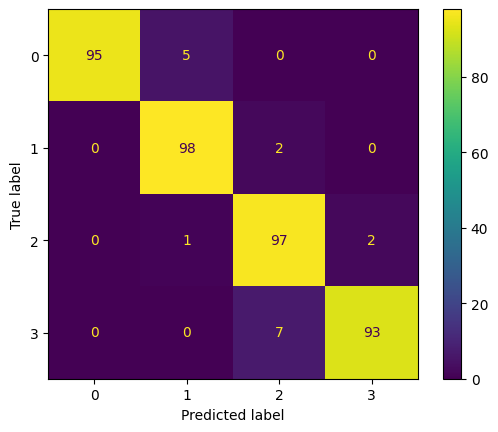

In [33]:
#confusion matrix
cm_lr = confusion_matrix(y_test, y_pred_lr_test, labels=[0, 1, 2, 3])
disp_lr = ConfusionMatrixDisplay(confusion_matrix=cm_lr, display_labels=[0, 1, 2, 3])
disp_lr.plot()

## Support Vector Machine

In [34]:
#Cross validation
score_svc = cross_val_score(pipe_svc, X_train, y_train, cv=10, scoring='accuracy')

print(score_svc)
print(score_svc.mean())

[0.83125 0.84375 0.81875 0.9     0.8625  0.85625 0.86875 0.84375 0.8875
 0.75   ]
0.8462499999999998


In [35]:
#hyperparameter tuning
param_svc = {
    'model__C': [0.1, 1, 10, 100],
    'model__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'model__gamma': ['scale', 'auto']
}

grid_svc = GridSearchCV(pipe_svc, param_grid=param_svc, cv=10, scoring='accuracy', n_jobs=-1, verbose=1)

grid_svc.fit(X_train, y_train)

grid_svc.best_params_

Fitting 10 folds for each of 32 candidates, totalling 320 fits


{'model__C': 100, 'model__gamma': 'scale', 'model__kernel': 'linear'}

In [36]:
#Train model and predict using best estimator
svc_best = grid_svc.best_estimator_
svc_best.fit(X_train, y_train)

y_pred_svc_train = svc_best.predict(X_train)
y_pred_svc_test = svc_best.predict(X_test)

print(classification_report(y_train, y_pred_svc_train))
print(classification_report(y_test, y_pred_svc_test))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       400
           1       0.95      0.96      0.96       400
           2       0.94      0.95      0.95       400
           3       0.98      0.96      0.97       400

    accuracy                           0.96      1600
   macro avg       0.96      0.96      0.96      1600
weighted avg       0.96      0.96      0.96      1600

              precision    recall  f1-score   support

           0       1.00      0.96      0.98       100
           1       0.95      0.99      0.97       100
           2       0.92      0.96      0.94       100
           3       0.97      0.93      0.95       100

    accuracy                           0.96       400
   macro avg       0.96      0.96      0.96       400
weighted avg       0.96      0.96      0.96       400



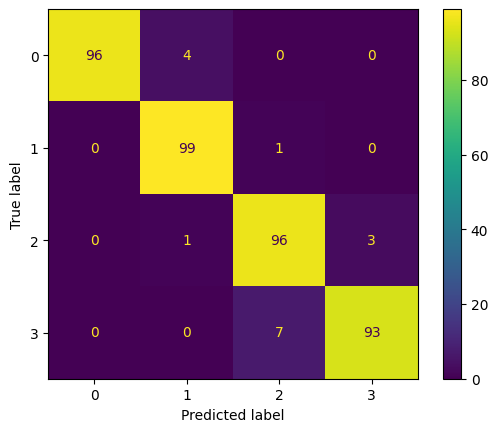

In [37]:
#confusion matrix
cm_svc = confusion_matrix(y_test, y_pred_svc_test, labels=[0, 1, 2, 3])
disp_svc = ConfusionMatrixDisplay(confusion_matrix=cm_svc, display_labels=[0, 1, 2, 3])
disp_svc.plot()

## KNN

In [38]:
#Cross validation
score_knn = cross_val_score(pipe_knn, X_train, y_train, cv=10, scoring='accuracy')

print(score_knn)
print(score_knn.mean())

[0.5375  0.54375 0.5625  0.5875  0.525   0.48125 0.54375 0.49375 0.60625
 0.4875 ]
0.536875


In [39]:
#hyperparameter tuning
param_knn = {
    'model__n_neighbors': [3, 5, 7, 9],
    'model__weights': ['uniform', 'distance'],
    'model__p': [1, 2]
}

grid_knn = GridSearchCV(pipe_knn, param_grid=param_knn, cv=10, scoring='accuracy', n_jobs=-1, verbose=1)

grid_knn.fit(X_train, y_train)

grid_knn.best_params_

Fitting 10 folds for each of 16 candidates, totalling 160 fits


{'model__n_neighbors': 9, 'model__p': 1, 'model__weights': 'distance'}

In [40]:
#Train model and predict using best estimator
knn_best = grid_knn.best_estimator_
knn_best.fit(X_train, y_train)

y_pred_knn_train = knn_best.predict(X_train)
y_pred_knn_test = knn_best.predict(X_test)

print(classification_report(y_train, y_pred_knn_train))
print(classification_report(y_test, y_pred_knn_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       400
           1       1.00      1.00      1.00       400
           2       1.00      1.00      1.00       400
           3       1.00      1.00      1.00       400

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600

              precision    recall  f1-score   support

           0       0.72      0.69      0.70       100
           1       0.50      0.50      0.50       100
           2       0.46      0.49      0.47       100
           3       0.72      0.70      0.71       100

    accuracy                           0.59       400
   macro avg       0.60      0.59      0.60       400
weighted avg       0.60      0.59      0.60       400



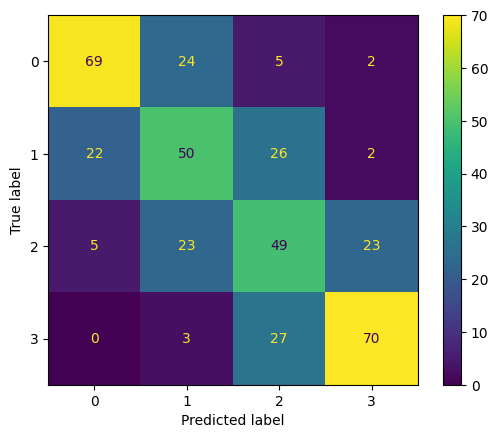

In [41]:
#confusion matrix
cm_knn = confusion_matrix(y_test, y_pred_knn_test, labels=[0, 1, 2, 3])
disp_knn = ConfusionMatrixDisplay(confusion_matrix=cm_knn, display_labels=[0, 1, 2, 3])
disp_knn.plot()

## Decision Tree

In [42]:
#Cross Validation
score_dt = cross_val_score(pipe_dt, X_train, y_train, cv=10, scoring='accuracy')

print(score_dt)
print(score_dt.mean())

[0.825   0.83125 0.8     0.85    0.875   0.86875 0.84375 0.83125 0.85
 0.7875 ]
0.8362499999999999


In [43]:
#hyperparameter tuning
param_dt = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [None, 3, 5, 7, 9],
    'model__min_samples_split': [2, 5, 10],
    'model__min_samples_leaf': [1, 2, 3, 4, 5]
}

grid_dt = GridSearchCV(pipe_dt, param_grid=param_dt, cv=10, scoring='accuracy')

grid_dt.fit(X_train, y_train)

grid_dt.best_params_

{'model__criterion': 'gini',
 'model__max_depth': 7,
 'model__min_samples_leaf': 1,
 'model__min_samples_split': 2}

In [44]:
#Train model and predict using best estimator
best_dt = grid_dt.best_estimator_
best_dt.fit(X_train, y_train)

y_pred_dt_train = best_dt.predict(X_train)
y_pred_dt_test = best_dt.predict(X_test)

print(classification_report(y_train, y_pred_dt_train))
print(classification_report(y_test, y_pred_dt_test))

              precision    recall  f1-score   support

           0       0.98      0.97      0.97       400
           1       0.93      0.94      0.94       400
           2       0.94      0.95      0.94       400
           3       0.99      0.97      0.98       400

    accuracy                           0.96      1600
   macro avg       0.96      0.96      0.96      1600
weighted avg       0.96      0.96      0.96      1600

              precision    recall  f1-score   support

           0       0.94      0.92      0.93       100
           1       0.84      0.83      0.83       100
           2       0.81      0.87      0.84       100
           3       0.95      0.91      0.93       100

    accuracy                           0.88       400
   macro avg       0.88      0.88      0.88       400
weighted avg       0.88      0.88      0.88       400



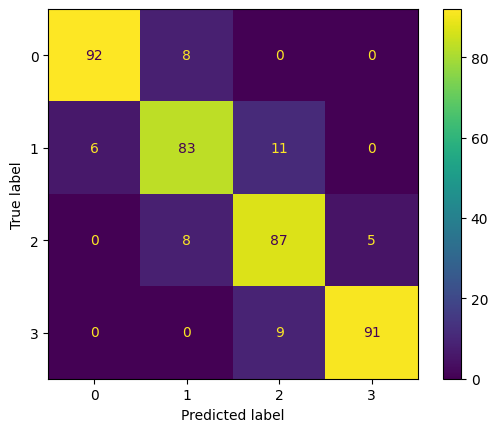

In [45]:
#confusion matrix
cm_dt = confusion_matrix(y_test, y_pred_dt_test, labels=[0, 1, 2, 3])
disp_dt = ConfusionMatrixDisplay(confusion_matrix=cm_dt, display_labels=[0, 1, 2, 3])
disp_dt.plot()

## Random Forest

In [46]:
#Cross Validation
score_rf = cross_val_score(pipe_rf, X_train, y_train, cv=10, scoring='accuracy')

print(score_rf)
print(score_rf.mean())

[0.85    0.88125 0.90625 0.93125 0.90625 0.925   0.91875 0.88125 0.94375
 0.88125]
0.9024999999999999


In [47]:
#hyperparameter tuning
param_rf = {
    'model__n_estimators': [100, 200, 300, 400, 500],
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [None, 2, 3, 4, 5, 6, 7, 8, 9, 10],
    'model__max_features': ['sqrt', 'log2']
}

grid_rf = GridSearchCV(pipe_rf, param_grid=param_rf, cv=10, scoring='accuracy', n_jobs=-1, verbose=1)

grid_rf.fit(X_train, y_train)

grid_rf.best_params_

Fitting 10 folds for each of 200 candidates, totalling 2000 fits


{'model__criterion': 'entropy',
 'model__max_depth': None,
 'model__max_features': 'log2',
 'model__n_estimators': 500}

In [48]:
#Train and predict again with best params
best_rf = grid_rf.best_estimator_
best_rf.fit(X_train, y_train)

y_pred_rf_train = best_rf.predict(X_train)
y_pred_rf_test = best_rf.predict(X_test)

print(classification_report(y_train, y_pred_rf_train))
print(classification_report(y_test, y_pred_rf_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       400
           1       1.00      1.00      1.00       400
           2       1.00      1.00      1.00       400
           3       1.00      1.00      1.00       400

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600

              precision    recall  f1-score   support

           0       0.96      0.95      0.95       100
           1       0.91      0.93      0.92       100
           2       0.90      0.88      0.89       100
           3       0.92      0.93      0.93       100

    accuracy                           0.92       400
   macro avg       0.92      0.92      0.92       400
weighted avg       0.92      0.92      0.92       400



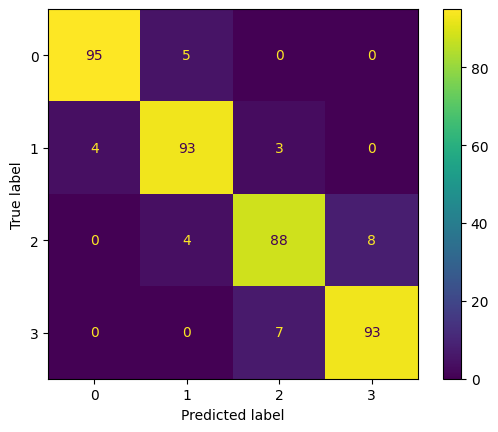

In [49]:
#confusion matrix
cm_rf = confusion_matrix(y_test, y_pred_rf_test, labels=[0, 1, 2, 3])
disp_rf = ConfusionMatrixDisplay(confusion_matrix=cm_rf, display_labels=[0, 1, 2, 3])
disp_rf.plot()

## Gadient Boosting Classifier

In [50]:
#Cross validation
score_gb = cross_val_score(pipe_gb, X_train, y_train, cv=10, scoring='accuracy')

print(score_gb)
print(score_gb.mean())

[0.84375 0.89375 0.9     0.9125  0.9     0.91875 0.9     0.89375 0.925
 0.88125]
0.896875


In [51]:
#hyperparameter tuning
param_gb = {
    'model__n_estimators': [100, 200, 300, 400, 500],
    'model__learning_rate': [0.001, 0.01, 0.1, 1],
    'model__max_depth': [None, 2, 3, 4, 5, 6, 7, 8, 9, 10],
    'model__max_features': ['sqrt', 'log2']
}

grid_gb = GridSearchCV(pipe_gb, param_grid=param_gb, cv=10, scoring='accuracy', n_jobs=-1, verbose=1)

grid_gb.fit(X_train, y_train)

grid_gb.best_params_

Fitting 10 folds for each of 400 candidates, totalling 4000 fits


{'model__learning_rate': 1,
 'model__max_depth': 2,
 'model__max_features': 'log2',
 'model__n_estimators': 200}

In [52]:
#Train and predict after hyperparameter tuning
best_gb = grid_gb.best_estimator_

best_gb.fit(X_train, y_train)

y_pred_gb_train = best_gb.predict(X_train)
y_pred_gb_test = best_gb.predict(X_test)

print(classification_report(y_train, y_pred_gb_train))
print(classification_report(y_test, y_pred_gb_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       400
           1       1.00      1.00      1.00       400
           2       1.00      1.00      1.00       400
           3       1.00      1.00      1.00       400

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600

              precision    recall  f1-score   support

           0       0.97      0.95      0.96       100
           1       0.92      0.91      0.91       100
           2       0.88      0.92      0.90       100
           3       0.95      0.93      0.94       100

    accuracy                           0.93       400
   macro avg       0.93      0.93      0.93       400
weighted avg       0.93      0.93      0.93       400



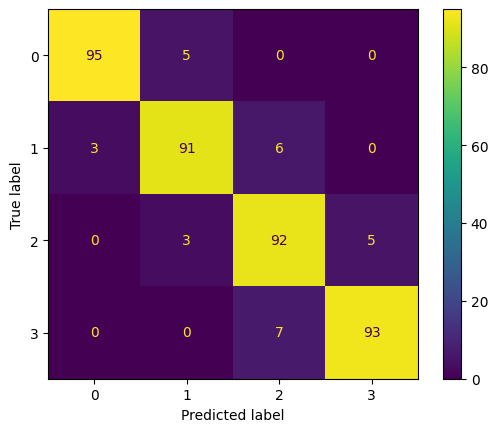

In [53]:
#confusion matrix
cm_gb = confusion_matrix(y_test, y_pred_gb_test, labels=[0, 1, 2, 3])
disp_gb = ConfusionMatrixDisplay(confusion_matrix=cm_gb, display_labels=[0, 1, 2, 3])
disp_gb.plot()

# Model Evaluation

In [54]:
#save mean score
all_report_mean = {}
cv_score_mean = {
    'Logistic Regression': score_lr.mean(),
    'SVC': score_svc.mean(),
    'KNN': score_knn.mean(),
    'Decision Tree': score_dt.mean(),
    'Random Forest': score_rf.mean(),
    'Gradient Boosting': score_gb.mean(),}

all_report_mean['CV Score (Mean & STD) Default Parameter'] = cv_score_mean
pd.DataFrame(all_report_mean)

,CV Score (Mean & STD) Default Parameter
Decision Tree,0.836250
Gradient Boosting,0.896875
KNN,0.536875
Logistic Regression,0.927500
Random Forest,0.902500
SVC,0.846250


In [55]:
#Save std score
all_report_std = {}
cv_score_std = {
    'Logistic Regression': score_lr.std(),
    'SVC': score_svc.std(),
    'KNN': score_knn.std(),
    'Decision Tree': score_dt.std(),
    'Random Forest': score_rf.std(),
    'Gradient Boosting': score_gb.std(),
    }

all_report_std['CV Score (Mean & STD) Default Parameter'] = cv_score_std
pd.DataFrame(all_report_std)


,CV Score (Mean & STD) Default Parameter
Decision Tree,0.026190
Gradient Boosting,0.021515
KNN,0.039573
Logistic Regression,0.016346
Random Forest,0.027272
SVC,0.039647


In [56]:
best_model_mean = max(cv_score_mean, key=cv_score_mean.get)
print('Best Model : ', best_model_mean)

Best Model :  Logistic Regression


In [57]:
best_model_std = min(cv_score_std, key=cv_score_std.get)
print('Best Model : ', best_model_std)

Best Model :  Logistic Regression


Confusion Matrix : Train Data


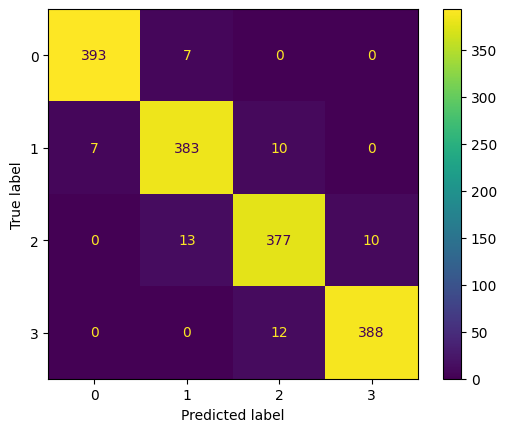

In [58]:
print('Confusion Matrix : Train Data')
cm_lr_train = confusion_matrix(y_train, y_pred_lr_train, labels=[0, 1, 2, 3])
disp_lr_train = ConfusionMatrixDisplay(confusion_matrix=cm_lr_train, display_labels=[0, 1, 2, 3])
disp_lr_train.plot()

Confusion Matrix : Test Data


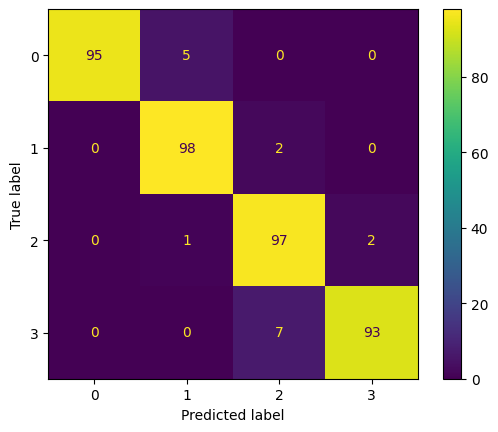

In [59]:
print('Confusion Matrix : Test Data')
disp_lr.plot()

Insight:

- Menggunakan metric `accuracy` dikarenakan data yang balance dan tidak ada yang perlu diminimalisir. Saya ingin melihat ketepatan model memprediksi harga dari spesifikasi yang diberikan sehingga accuracy adalah metric yang tepat.
- Model yang terbaik berdasarkan Cross Validation baik dengan melihat rata - rata akurasi dan standar deviasinya adalah `Logistic Regression`.
- kemudian Melakukan Hyperparameter Tuning pada Model Logistic Regression, nilai accuracy pada cross validation yang tertinggi adalah `0,95` setelah dilakukan hyperparameter tuning menjadi `0,96`.
- Parameter yang digunakan adalah {'model__C': 100, 'model__max_iter': 2000, 'model__solver': 'newton-cg'}.
- Ketika melihat confusion matrix dapat kita lihat hasil prediksi bagus. Prediksi yang gagal sangat sedikit dibandingkan prediksi yang tepat.

# Save

In [60]:
logreg_best

Pipeline(steps=[('transform',
                 ColumnTransformer(transformers=[('numeric',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler()),
                                                                  ('imputer',
                                                                   'passthrough')]),
                                                  ['battery_power',
                                                   'clock_speed', 'fc',
                                                   'int_memory', 'pc',
                                                   'px_height', 'px_width',
                                                   'ram']),
                                                 ('categorical',
                                                  Pipeline(steps=[('imputer',
                                                                   'passthrough')]),
                                                  ['four_g', 'n_cores'])])),
                ('model',
                 LogisticRegression(C=100, max_iter=2000, solver='newton-cg'))])

In [61]:
#save model
joblib.dump(logreg_best, open('specPrice_pred.pkl', 'wb'))

# Kesipulan

Problem : Seorang bos besar dari negara x ingin membuat perusahaan mobile phone namun tidak dapat menentukan range harganya. 

Dengan model yang telah saya buat, bos tersebut bisa memprediksi harga mobile phone tersebut berdasarkan spesifikasinya. Model yang telah dibuat adalah model yang bestfit, yang berarti model dapat memprediksi range harga dengan cukup tepat. Saya cukup yakin model ini dapat digunakan pada perusahaan bos tersebut.

Untuk Kelebihan, model ini sudah cukup bagus untuk memprediksi range harga mobile phone.

Untuk kekurangannya, saya sendiri belum menemukannya.

Untuk saran, bisa mencoba lebih banyak model - model yang lain. Bisa saja ada model yang lebih bagus dari linar regression yang saya gunakan.